<a href="https://colab.research.google.com/github/arpitawad04/League-Of-Legends-Pre-Match-Winner-Prediction-And-Recommendation-of-Champion-Using-Python/blob/main/MSE_LOL_Recommendation_engine_final_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

It is a type of recommendation system which works on the principle of popularity and or anything which is in trend. These systems check about the product or movie which are in trend or are most popular among the users and directly recommend those.

 

For example, if a product is often purchased by most people then the system will get to know that that product is most popular so for every new user who just signed it, the system will recommend that product to that user also and chances becomes high that the new user will also purchase that. 

We have implemented same concept in recommendation of Champion in a very popular MOBA game LEAGUE OF LEGENDS for any player who wants to know which champion is trending or most played and among them who has highest win rates.\
Our recommendation system will recommend Top 5 champion to the player arranged from champion with highest win rates at top and lowest at bottom.
As motive of every player playing game League of Legends is to win a Game,this recommendation system will help them in selecting the suitable player on the basis of data available.
There is probability that may be the top champion in recommended list is not available to the player,therefore we are recommending top5 champion.Any player can be choosen on the basis of his choice,skills,interest.
Basically this will recommend a player  "champions" at every position a Player wants to play.Beacuse recommendation system uses thousands of records of Ranked matches played across the country by different skilled players,which will help player in selecting Champion which will give high probability of winning the Game.

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

import warnings; warnings.simplefilter('ignore')
%matplotlib inline

In [ ]:
df_lol=pd.read_csv("/content/2021_LoL_esports_match_data_from_OraclesElixir_20220216.csv",header=0)

#Load dataset:
Dataset contains more than 1lakh plus records.We have loaded only approximate 1lakh records.\
Loading of data will take some time.

In [ ]:
df_lol.shape

(100708, 123)

Have a look at Data.

In [ ]:
df_lol.head()

,gameid,datacompleteness,url,league,year,split,playoffs,date,game,patch,participantid,side,position,playername,playerid,teamname,teamid,champion,ban1,ban2,ban3,ban4,ban5,gamelength,result,kills,deaths,assists,teamkills,teamdeaths,doublekills,triplekills,quadrakills,pentakills,firstblood,firstbloodkill,firstbloodassist,firstbloodvictim,team kpm,ckpm,...,earned gpm,earnedgoldshare,goldspent,gspd,total cs,minionkills,monsterkills,monsterkillsownjungle,monsterkillsenemyjungle,cspm,goldat10,xpat10,csat10,opp_goldat10,opp_xpat10,opp_csat10,golddiffat10,xpdiffat10,csdiffat10,killsat10,assistsat10,deathsat10,opp_killsat10,opp_assistsat10,opp_deathsat10,goldat15,xpat15,csat15,opp_goldat15,opp_xpat15,opp_csat15,golddiffat15,xpdiffat15,csdiffat15,killsat15,assistsat15,deathsat15,opp_killsat15,opp_assistsat15,opp_deathsat15
0,ESPORTSTMNT03/1632489,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2021,NaN,0,2021-01-02 07:40:39,1,10.25,1,Blue,top,Khan,oe:player:b9972f46c1e52797d66236b118d2970,DWG KIA,oe:team:2e79800a550f87f2378dbba9368396d,Mordekaiser,Aatrox,Kai'Sa,Pantheon,Aphelios,Lucian,1782,1,7,1,3,23,4,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.7744,0.9091,...,274.5455,0.196019,10875.0,NaN,209.0,193.0,16.0,8.0,5.0,7.0370,3421.0,5043.0,73.0,2985.0,4493.0,72.0,436.0,550.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,5407.0,7536.0,114.0,4659.0,7592.0,118.0,748.0,-56.0,-4.0,2.0,0.0,1.0,0.0,1.0,1.0
1,ESPORTSTMNT03/1632489,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2021,NaN,0,2021-01-02 07:40:39,1,10.25,2,Blue,jng,Canyon,oe:player:92544d7a994bd6841cccd9f6e42e3de,DWG KIA,oe:team:2e79800a550f87f2378dbba9368396d,Graves,Aatrox,Kai'Sa,Pantheon,Aphelios,Lucian,1782,1,7,1,5,23,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7744,0.9091,...,337.8114,0.241189,13850.0,NaN,259.0,41.0,218.0,110.0,43.0,8.7205,3497.0,4314.0,87.0,3055.0,3059.0,62.0,442.0,1255.0,25.0,0.0,0.0,0.0,0.0,0.0,0.0,6974.0,8232.0,146.0,4854.0,4827.0,84.0,2120.0,3405.0,62.0,3.0,2.0,0.0,2.0,0.0,3.0
2,ESPORTSTMNT03/1632489,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2021,NaN,0,2021-01-02 07:40:39,1,10.25,3,Blue,mid,ShowMaker,oe:player:5f8ff49cd56eae61d635966b183a451,DWG KIA,oe:team:2e79800a550f87f2378dbba9368396d,Zoe,Aatrox,Kai'Sa,Pantheon,Aphelios,Lucian,1782,1,5,0,8,23,4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7744,0.9091,...,348.9226,0.249122,12700.0,NaN,299.0,250.0,49.0,17.0,24.0,10.0673,3784.0,5171.0,114.0,3301.0,4822.0,91.0,483.0,349.0,23.0,0.0,0.0,0.0,0.0,0.0,0.0,6591.0,7827.0,158.0,5013.0,7473.0,143.0,1578.0,354.0,15.0,2.0,3.0,0.0,0.0,0.0,0.0
3,ESPORTSTMNT03/1632489,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2021,NaN,0,2021-01-02 07:40:39,1,10.25,4,Blue,bot,Ghost,oe:player:78081d0b3c01f1f295d52d53744261a,DWG KIA,oe:team:2e79800a550f87f2378dbba9368396d,Miss Fortune,Aatrox,Kai'Sa,Pantheon,Aphelios,Lucian,1782,1,3,2,11,23,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7744,0.9091,...,309.2929,0.220828,11925.0,NaN,292.0,265.0,27.0,17.0,4.0,9.8316,3540.0,3354.0,94.0,3020.0,3053.0,75.0,520.0,301.0,19.0,0.0,0.0,0.0,0.0,0.0,0.0,5202.0,5053.0,130.0,5078.0,4951.0,120.0,124.0,102.0,10.0,0.0,4.0,2.0,1.0,1.0,2.0
4,ESPORTSTMNT03/1632489,complete,http://matchhistory.na.leagueoflegends.com/en/...,KeSPA,2021,NaN,0,2021-01-02 07:40:39,1,10.25,5,Blue,sup,BeryL,oe:player:dee54127bb56d2e2540ba71cc416f1c,DWG KIA,oe:team:2e79800a550f87f2378dbba9368396d,Galio,Aatrox,Kai'Sa,Pantheon,Aphelios,Lucian,1782,1,1,0,14,23,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7744,0.9091,...,130.0337,0.092842,7000.0,NaN,37.0,37.0,0.0,0.0,0.0,1.2458,2049.0,2577.0,14.0,2137.0,2667.0,17.0,-88.0,-90.0,-3.0,0.0,0.0,0.0,0.0,0.0,0.0,3853.0,4681.0,28.0,3405.0,4231.0,25.0,448.0,450.0,3.0,1.0,4.0,0.0,0.0,2.0,2.0


In [ ]:
#Get information about Dataframe
df_lol.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100708 entries, 0 to 100707
Columns: 123 entries, gameid to opp_deathsat15
dtypes: float64(93), int64(12), object(18)
memory usage: 94.5+ MB


In [ ]:
#Find null values in dataframe.
df_lol.isnull().sum()

gameid                 24
datacompleteness    22048
url                     0
league                  0
year                    0
                    ...  
assistsat15          5521
deathsat15           5521
opp_killsat15        5521
opp_assistsat15      5521
opp_deathsat15       5521
Length: 123, dtype: int64

In [ ]:
#Get array of columns in dataframe.
df_lol.columns

Index(['gameid', 'datacompleteness', 'url', 'league', 'year', 'split',
       'playoffs', 'date', 'game', 'patch',
       ...
       'opp_csat15', 'golddiffat15', 'xpdiffat15', 'csdiffat15', 'killsat15',
       'assistsat15', 'deathsat15', 'opp_killsat15', 'opp_assistsat15',
       'opp_deathsat15'],
      dtype='object', length=123)

#Create another Dataframe having only Playerid,Champion,Match Result,Position played.

In [ ]:
#Create subset of original dataframe
df_lol_champ_pos=df_lol[['playerid','champion','result','position']]

df_lol_champ_pos.head()

,playerid,champion,result,position
0,oe:player:b9972f46c1e52797d66236b118d2970,Mordekaiser,1,top
1,oe:player:92544d7a994bd6841cccd9f6e42e3de,Graves,1,jng
2,oe:player:5f8ff49cd56eae61d635966b183a451,Zoe,1,mid
3,oe:player:78081d0b3c01f1f295d52d53744261a,Miss Fortune,1,bot
4,oe:player:dee54127bb56d2e2540ba71cc416f1c,Galio,1,sup


In [ ]:
#Find the number of null values in dataframe
df_lol_champ_pos.isnull().sum()

playerid    0
champion    0
result      0
position    0
dtype: int64

In [ ]:
#Drop Null values
df_lol_champ_pos.dropna(inplace=True)
df_lol_champ_pos['position'].unique()

array(['top', 'jng', 'mid', 'bot', 'sup'], dtype=object)

#Recommendation For Champion playing at Mage position:
From the complete dataframe ,we are finding records of players played at "MID" position because this is Default positon for Mage in the Game League of Legend.

In [ ]:
df_mages=df_lol_champ_pos[df_lol_champ_pos['position']=='mid']
df_mages.head()

,playerid,champion,result,position
2,oe:player:5f8ff49cd56eae61d635966b183a451,Zoe,1,mid
7,oe:player:0582fabc486c42d0db3bf52f56c6fc3,Orianna,0,mid
14,oe:player:0582fabc486c42d0db3bf52f56c6fc3,Rumble,0,mid
19,oe:player:5f8ff49cd56eae61d635966b183a451,Syndra,1,mid
26,oe:player:0582fabc486c42d0db3bf52f56c6fc3,Zoe,0,mid


Create another dataframe through groupby 'playerid' and 'champion' and evaluate "Win rate" for each player by champion.
"Result here represent "win_rate".

In [ ]:
df_mages_groupby_champ=df_mages.groupby(['playerid','champion']).aggregate({'result':'mean'})
df_mages_groupby_champ.reset_index(level=[0,1],inplace=True)
df_mages_groupby_champ.head()

,playerid,champion,result
0,oe:player:007bfe2ac0ea4e76e237db6e04c124f,Karma,0.0
1,oe:player:007bfe2ac0ea4e76e237db6e04c124f,Katarina,0.0
2,oe:player:007bfe2ac0ea4e76e237db6e04c124f,Orianna,0.0
3,oe:player:007bfe2ac0ea4e76e237db6e04c124f,Ryze,1.0
4,oe:player:007bfe2ac0ea4e76e237db6e04c124f,Sylas,0.0


Find the count of number of games played by every player by "playerid" 

In [ ]:
counts_mages=df_mages_groupby_champ.playerid.value_counts()
counts_mages.head(10)

oe:player:f886838ee1808c2f217208267a829ce    25
oe:player:2dbc3f1de119e0fef4568bc9e1ce1d4    25
oe:player:4c992404b9946c957aac7c12dd061ed    24
oe:player:0634d9e86284da2fae4e1438d564eee    24
oe:player:1c275bedd474301abb6a402792d0731    23
oe:player:fb6e61b8acb05df17b7e5ad4ae7c800    23
oe:player:5257e05cde806e07b405ddcce85114d    22
oe:player:cda093b28f577696b82604fb20037ad    22
oe:player:817434295a673aed431435658b65d9a    22
oe:player:05a73863e113f3cb6b472a76da2ea52    22
Name: playerid, dtype: int64

#Take players only who has appeared at Mid position in dataframe more than 15 times.

In [ ]:
df_mages_groupby_champ_greater_15=df_mages_groupby_champ[df_mages_groupby_champ.playerid.isin(counts_mages[counts_mages>=15].index)]
print('Number of players who have palyed 15 games or more =', len(df_mages_groupby_champ_greater_15))
print('Number of unique players in the final data = ', df_mages_groupby_champ_greater_15['playerid'].nunique())
print('Number of unique champions in the final data = ', df_mages_groupby_champ_greater_15['champion'].nunique())

Number of players who have palyed 15 games or more = 2581
Number of unique players in the final data =  147
Number of unique champions in the final data =  88


#Pivot table of Each player and champion along with respective winrates.

In [ ]:
df_mages_groupby_champ_greater_15_pivot=df_mages_groupby_champ_greater_15.pivot(index = 'playerid', columns ='champion', values = 'result').fillna(0)
df_mages_groupby_champ_greater_15_pivot.head()

champion,Aatrox,Ahri,Akali,Alistar,Anivia,Annie,Aurelion Sol,Azir,Brand,Camille,Cassiopeia,Corki,Darius,Diana,Draven,Ekko,Ezreal,Fizz,Galio,Gangplank,Garen,Gnar,Gragas,Graves,Gwen,Irelia,Jax,Jayce,Kalista,Karma,Kassadin,Katarina,Kayle,Kayn,Kindred,Kled,Kog'Maw,LeBlanc,Lee Sin,Lillia,...,Nocturne,Olaf,Orianna,Ornn,Pantheon,Poppy,Qiyana,Rell,Renekton,Riven,Rumble,Ryze,Senna,Seraphine,Sett,Sion,Soraka,Swain,Sylas,Syndra,Taliyah,Talon,Tristana,Tryndamere,Twisted Fate,Vayne,Veigar,Vel'Koz,Viego,Viktor,Vladimir,Volibear,Xerath,Xin Zhao,Yasuo,Yone,Zed,Ziggs,Zilean,Zoe
playerid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
oe:player:014c50a8bcb2f8965db2fa367330876,0.0,0.0,0.750000,0.0,0.0,0.0,0.0,1.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.800000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.500000,0.0,0.0,0.0,0.0,0.000000,0.00,0.0,0.0,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,1.000000,0.0,0.0,0.0,1.000000
oe:player:01787aabae63131ebea6c25c4ff37cb,0.0,0.0,0.500000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.333333,0.0,0.000000,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.000000,0.5,0.0,0.0,0.0,0.333333,0.00,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.285714,0.0,0.0,0.0,0.0,0.75,0.400000,0.0,0.0,0.0,0.000000
oe:player:054016060c27c4a87fe02adb6667d1f,0.0,0.0,0.333333,0.0,0.0,0.0,0.0,0.500000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.750000,1.0,0.0,...,0.0,0.0,0.400000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.333333,0.0,0.666667,0.6,0.0,0.0,0.0,0.400000,0.00,0.0,0.0,0.000000,0.0,0.5,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,0.00,0.500000,1.0,0.0,0.0,0.333333
oe:player:05a73863e113f3cb6b472a76da2ea52,1.0,0.0,0.500000,0.0,0.0,0.0,0.0,0.357143,0.0,0.0,0.8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,...,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.250000,0.0,0.0,0.0,0.0,0.333333,0.25,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.684211,0.0,0.0,1.0,0.0,0.00,0.000000,0.0,1.0,0.0,0.500000
oe:player:0634d9e86284da2fae4e1438d564eee,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,0.600000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.666667,0.5,0.0,...,1.0,0.0,0.625000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.600000,0.00,0.0,0.0,0.833333,0.0,0.5,0.0,0.0,0.0,0.0,0.200000,0.0,0.0,0.0,0.0,1.00,0.714286,0.0,0.0,0.0,1.000000


Splitting the dataframe into train-test.

In [ ]:
#Split the data randomnly into train and test datasets into 70:30 ratio
train_data_mages, test_data_mages = train_test_split(df_mages_groupby_champ_greater_15, test_size = 0.3, random_state=0)
train_data_mages.head()

,playerid,champion,result
3073,oe:player:78f78a8aa2c5d6bae8a64d6950bbb0f,Lucian,1.0
5231,oe:player:ce280cfcaa8d028bf7400e597eb666c,Irelia,1.0
3278,oe:player:817434295a673aed431435658b65d9a,Renekton,1.0
694,oe:player:1fc5efe020980df2413a97ce9f2f586,Azir,0.0
6134,oe:player:ea9ed09584feecae0991089f087d2ce,Seraphine,0.8


#Groupby Champion ,find win_rate for each champion and count how many times that champion is chosen.

In [ ]:
train_data_mages_grouped = train_data_mages.groupby('champion').agg({'result': 'mean'}).reset_index()
train_data_mages_grouped.rename(columns = {'result': 'win_rate'},inplace=True)
num_of_times_chosen=train_data_mages.groupby('champion').agg({'result': 'count'}).reset_index()
train_data_mages_grouped['no_of_time_chosen']=num_of_times_chosen['result']
train_data_mages_grouped.head(10)

,champion,win_rate,no_of_time_chosen
0,Aatrox,0.666667,6
1,Ahri,0.555128,13
2,Akali,0.521573,77
3,Alistar,1.000000,1
4,Anivia,0.260000,15
5,Annie,0.666667,3
6,Aurelion Sol,0.937500,2
7,Azir,0.470035,79
8,Camille,0.500000,2
9,Cassiopeia,0.458696,23


In [ ]:
#Take champion choosen only more than 10 times to reduce the number of records.
train_data_mages_grouped_greater_5=train_data_mages_grouped[train_data_mages_grouped['no_of_time_chosen']>10]

In [ ]:
#Sort the "Champion" on recommended "win Rate".
train_data_mages_grouped_greater_5_sort = train_data_mages_grouped_greater_5.sort_values(['win_rate','no_of_time_chosen','champion'], ascending = [0,0,1]) 
      
#Generate a recommendation rank based upon "Win Rate ""
train_data_mages_grouped_greater_5_sort['rank'] = train_data_mages_grouped_greater_5_sort['win_rate'].rank(ascending=0, method='first') 
          
#Get the top 5 recommendations 
popularity_recommendations = train_data_mages_grouped_greater_5_sort.head(5) 
popularity_recommendations 

,champion,win_rate,no_of_time_chosen,rank
53,Rumble,0.615385,13,1.0
47,Pantheon,0.607143,14,2.0
26,Kassadin,0.593750,16,3.0
43,Nocturne,0.587838,37,4.0
49,Qiyana,0.583333,18,5.0


Function is created,which takes "Playerid" as input parameter and generate recommended output,containing top 5 champion on the decreasing order of Win rates at Mid/Mage Position.

In [ ]:
# Use popularity based recommender model to make predictions
def recommend(player_id):     
    user_recommendations = popularity_recommendations 
          
    #Add playerid column for which the recommendations are being generated 
    user_recommendations['playerid'] = player_id 
      
    #Bring playerid column to the front 
    cols = user_recommendations.columns.tolist() 
    cols = cols[-1:] + cols[:-1] 
    user_recommendations = user_recommendations[cols] 
          
    return user_recommendations 

#Recommendation for player "XYZ" came out as given below.

In [ ]:
recommend("XYZ")

,playerid,champion,win_rate,no_of_time_chosen,rank
53,XYZ,Rumble,0.615385,13,1.0
47,XYZ,Pantheon,0.607143,14,2.0
26,XYZ,Kassadin,0.593750,16,3.0
43,XYZ,Nocturne,0.587838,37,4.0
49,XYZ,Qiyana,0.583333,18,5.0


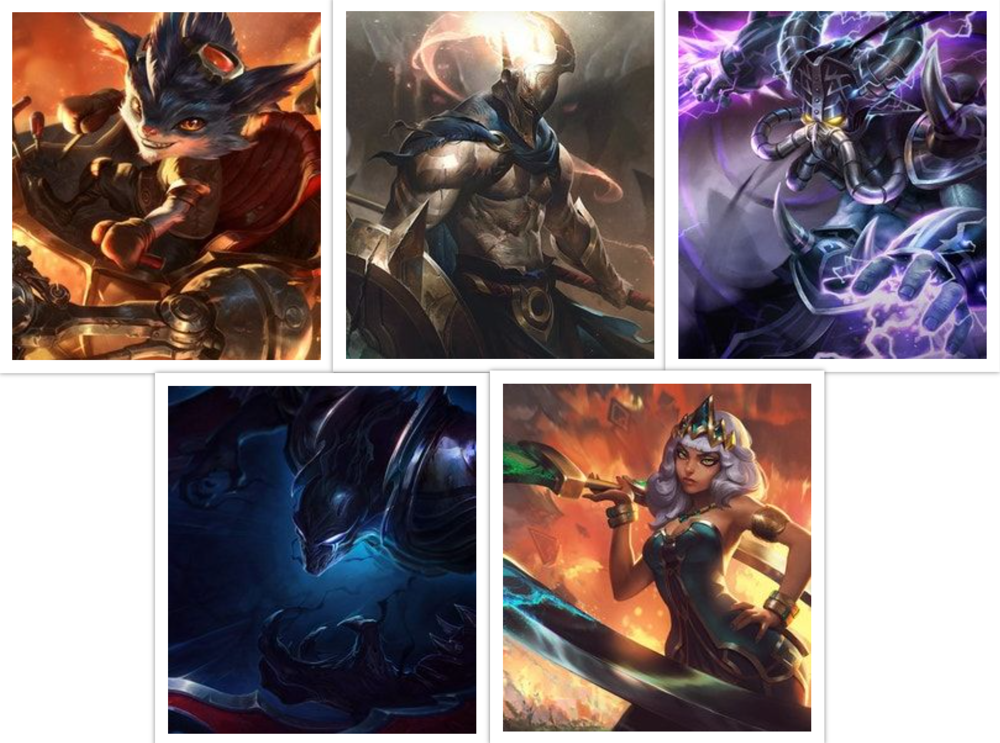

In [ ]:
#Import library
from IPython.display import Image
# Load image from local storage
Image(filename = "/content/collage_mage.png", width = 700, height = 600)

In [ ]:
mages=np.array(df_mages['champion'].unique())
mages


#Recommendation For Champion playing at Jungler position:
From the complete dataframe ,we are finding records of players played at "jungler" position because this is Default positon for Jungler in the Game League of Legend

In [ ]:
df_jungler=df_lol_champ_pos[df_lol_champ_pos['position']=='jng']
df_jungler.head()

,playerid,champion,result,position
1,oe:player:92544d7a994bd6841cccd9f6e42e3de,Graves,1,jng
6,oe:player:dda4a873265dfd06df50a0d8a294908,Kindred,0,jng
13,oe:player:dda4a873265dfd06df50a0d8a294908,Graves,0,jng
18,oe:player:92544d7a994bd6841cccd9f6e42e3de,Olaf,1,jng
25,oe:player:dda4a873265dfd06df50a0d8a294908,Graves,0,jng


Create another dataframe through groupby 'playerid' and 'champion' and evaluate "Win rate" for each player by champion.
"Result here represent "win_rate".

In [ ]:
df_junglers_groupby_champ=df_jungler.groupby(['playerid','champion']).aggregate({'result':'mean'})
df_junglers_groupby_champ.reset_index(level=[0,1],inplace=True)
df_junglers_groupby_champ.head()

,playerid,champion,result
0,oe:player:00710df3d8e256fd300625f22067ef2,Elise,0.00
1,oe:player:00710df3d8e256fd300625f22067ef2,Graves,0.25
2,oe:player:00710df3d8e256fd300625f22067ef2,Hecarim,0.20
3,oe:player:00710df3d8e256fd300625f22067ef2,Lee Sin,0.20
4,oe:player:00710df3d8e256fd300625f22067ef2,Lillia,0.50


Find the count of number of games played by every player by "playerid" 

In [ ]:
counts_junglers=df_junglers_groupby_champ.playerid.value_counts()
counts_junglers.head(10)

oe:player:8fc493f55239d3e33a7f3e0cc3e2471    23
oe:player:ec49ee309f41de6026b88d00ac081c4    23
oe:player:b0a4ae62486ca215c199e72698738b7    21
oe:player:a57c46c636a00b1721780dd44f9c42f    20
oe:player:a2de87eae98d0ab3b85567026561a51    20
oe:player:3903aab323863bd2e9b68218a7a65eb    20
oe:player:b021d02e17045078576b0bb66fae869    20
oe:player:62192a0e29076af0b79fb1ccaca9d18    20
oe:player:59c444e9797d923e639dfb6ba9f46bf    19
oe:player:350c3943975ec551bc23651debada3f    19
Name: playerid, dtype: int64

#Take players only who has appeared at Jungler position in dataframe more than 15 times.

In [ ]:
df_junglers_groupby_champ_greater_15=df_junglers_groupby_champ[df_junglers_groupby_champ.playerid.isin(counts_junglers[counts_junglers>=15].index)]
print('Number of players who have palyed 15 games or more =', len(df_junglers_groupby_champ_greater_15))
print('Number of unique players in the final data = ', df_junglers_groupby_champ_greater_15['playerid'].nunique())
print('Number of unique champions in the final data = ', df_junglers_groupby_champ_greater_15['champion'].nunique())

Number of players who have palyed 15 games or more = 1606
Number of unique players in the final data =  96
Number of unique champions in the final data =  53


#Pivot table of Each player and champion along with respective winrates.

In [ ]:
df_junglers_groupby_champ_greater_15_pivot=df_junglers_groupby_champ_greater_15.pivot(index = 'playerid', columns ='champion', values = 'result').fillna(0)
df_junglers_groupby_champ_greater_15_pivot.head()

champion,Aatrox,Cho'Gath,Darius,Diana,Dr. Mundo,Ekko,Elise,Evelynn,Fiddlesticks,Garen,Gragas,Graves,Gwen,Hecarim,Ivern,Jarvan IV,Jax,Karthus,Kayn,Kha'Zix,Kindred,Lee Sin,Lillia,Malphite,Mordekaiser,Morgana,Nidalee,Nocturne,Nunu & Willump,Olaf,Ornn,Pantheon,Poppy,Rek'Sai,Rengar,Riven,Rumble,Sejuani,Sett,Shaco,Shyvana,Skarner,Sylas,Taliyah,Trundle,Udyr,Vi,Viego,Volibear,Wukong,Xin Zhao,Yasuo,Zac
playerid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
oe:player:00710df3d8e256fd300625f22067ef2,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.200000,0.500000,0.0,0.0,0.0,0.888889,0.333333,0.0,0.666667,0.0,0.5,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.75,0.0,1.0,0.500000,0.0,0.666667,0.0,0.0
oe:player:03363ad17685d448dc06c1f252c1896,0.0,0.0,0.0,1.000,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.000000,0.0,0.500000,0.0,0.0,0.0,0.0,0.0,0.5,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,1.0,0.0,0.0,1.000000,0.0,0.0,0.0,0.0,1.0,0.0,1.000000,0.0,0.50,0.0,0.0,0.000000,0.0,1.000000,0.0,0.0
oe:player:08936c56ab5a6453c58974a619651c3,0.0,0.0,0.0,1.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.526316,0.0,0.333333,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.571429,0.428571,0.0,0.0,0.0,0.666667,0.000000,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.5,0.0,0.0,0.0,0.0,0.0,0.250000,0.5,0.25,0.0,0.0,0.600000,0.0,1.000000,0.0,0.0
oe:player:0973ddfd8ce96a62e85badbe503d163,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.800000,0.0,0.500000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.666667,0.0,0.0,0.0,0.833333,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.50,0.0,0.0,0.333333,0.0,1.000000,0.0,0.0
oe:player:0e8c08918017e086c42a9a250969768,0.0,0.0,0.0,0.625,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.400000,0.0,1.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.800000,0.777778,0.0,0.0,1.0,0.500000,0.000000,0.0,0.333333,0.0,1.0,0.0,0.0,0.0,0.0,0.545455,0.0,0.0,0.0,0.0,0.0,0.0,0.333333,0.0,0.25,0.0,0.0,0.000000,0.0,0.750000,0.0,0.0


In [ ]:
#Split the data randomnly into train and test datasets into 70:30 ratio
train_data_junglers, test_data_junglers = train_test_split(df_junglers_groupby_champ_greater_15, test_size = 0.3, random_state=0)
train_data_junglers.head()

,playerid,champion,result
4268,oe:player:b021d02e17045078576b0bb66fae869,Taliyah,1.0
5359,oe:player:df3e7f4eef306da0e300b26a7c92b00,Pantheon,1.0
4150,oe:player:a88f9b1cfb0beebb9aee272513500a6,Sejuani,0.0
3284,oe:player:84e02b3ad83040a2b876001dd6c5192,Pantheon,0.5
3887,oe:player:9d6488594f3b57d54e5610fd5c085e5,Xin Zhao,1.0


#Groupby Champion ,find win_rate for each champion and count how many times that champion is chosen.

In [ ]:
train_data_junglers_grouped = train_data_junglers.groupby('champion').agg({'result': 'mean'}).reset_index()
train_data_junglers_grouped.rename(columns = {'result': 'win_rate'},inplace=True)
num_of_times_chosen=train_data_junglers.groupby('champion').agg({'result': 'count'}).reset_index()
train_data_junglers_grouped['no_of_time_chosen']=num_of_times_chosen['result']
train_data_junglers_grouped.head(10)

,champion,win_rate,no_of_time_chosen
0,Aatrox,0.000000,1
1,Darius,0.500000,2
2,Diana,0.485638,47
3,Dr. Mundo,0.409722,24
4,Ekko,0.513889,6
5,Elise,0.363636,11
6,Evelynn,0.380952,7
7,Fiddlesticks,0.571429,7
8,Garen,0.388889,2
9,Gragas,0.460145,23


In [ ]:
#Take champion choosen only more than 10 times to reduce the number of records.
train_data_junglers_grouped_greater_5=train_data_junglers_grouped[train_data_junglers_grouped['no_of_time_chosen']>10]

In [ ]:
#Sort the "Champion" on recommended "win Rate". 
train_data_junglers_grouped_greater_5_sort = train_data_junglers_grouped_greater_5.sort_values(['win_rate','no_of_time_chosen','champion'], ascending = [0,0,1]) 
      
#Generate a recommendation rank based upon "Win Rate ""
train_data_junglers_grouped_greater_5_sort['rank'] = train_data_junglers_grouped_greater_5_sort['win_rate'].rank(ascending=0, method='first') 
          
#Get the top 5 recommendations 
popularity_recommendations = train_data_junglers_grouped_greater_5_sort.head(5) 
popularity_recommendations 

,champion,win_rate,no_of_time_chosen,rank
46,Xin Zhao,0.658532,56,1.0
23,Morgana,0.605037,26,2.0
41,Trundle,0.583333,14,3.0
14,Jarvan IV,0.556548,28,4.0
40,Taliyah,0.551409,49,5.0


Function is created,which takes "Playerid" as input parameter and generate recommended output,containing top 5 champion on the decreasing order of Win rates at Jungler Position.

In [ ]:
# Use popularity based recommender model to make predictions
def recommend(player_id):     
    user_recommendations = popularity_recommendations 
          
    #Add playerid column for which the recommendations are being generated 
    user_recommendations['playerid'] = player_id 
      
    #Bring playerid column to the front 
    cols = user_recommendations.columns.tolist() 
    cols = cols[-1:] + cols[:-1] 
    user_recommendations = user_recommendations[cols] 
          
    return user_recommendations 

#Recommendation for player "abcd" came out as given below.

In [ ]:
recommend("abcd")

,playerid,champion,win_rate,no_of_time_chosen,rank
46,abcd,Xin Zhao,0.658532,56,1.0
23,abcd,Morgana,0.605037,26,2.0
41,abcd,Trundle,0.583333,14,3.0
14,abcd,Jarvan IV,0.556548,28,4.0
40,abcd,Taliyah,0.551409,49,5.0


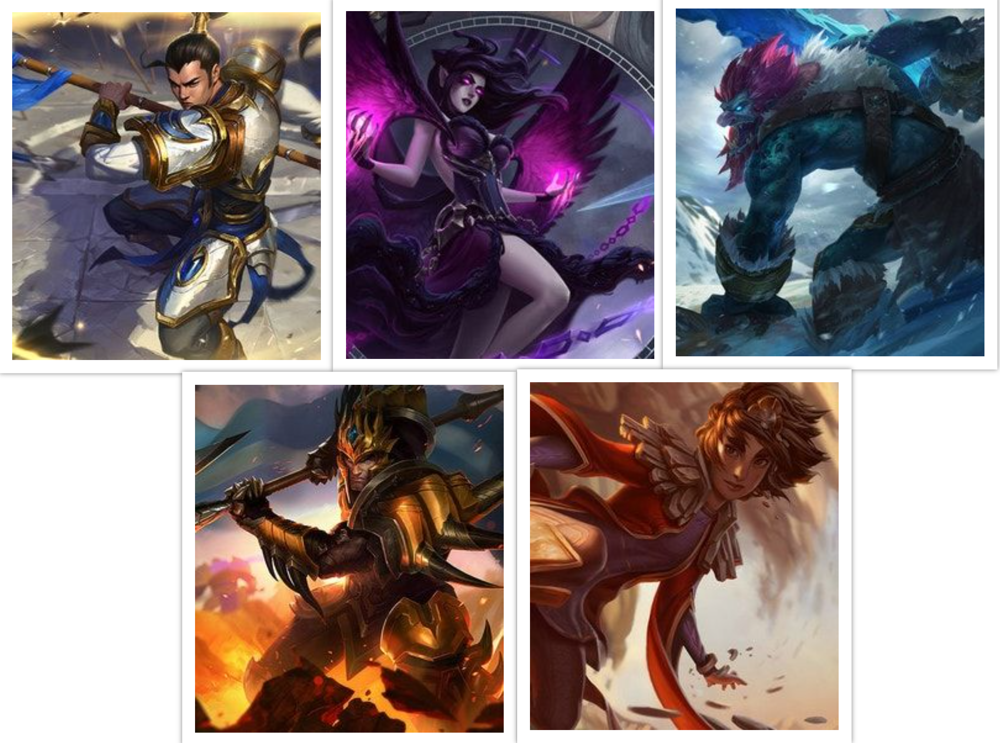

In [ ]:
# Load image from local storage
Image(filename = "/content/collage_jungle.png", width = 700, height = 600)

In [ ]:
junglers=np.array(df_jungler['champion'].unique())
junglers

#Recommendation For Champion playing at Top position:
From the complete dataframe ,we are finding records of players played at "Top" position because this is Default positon for players wants to play at TOP in the Game League of Legend

In [ ]:
df_top=df_lol_champ_pos[df_lol_champ_pos['position']=='top']
df_top.head()

,playerid,champion,result,position
0,oe:player:b9972f46c1e52797d66236b118d2970,Mordekaiser,1,top
5,oe:player:6fbf57b984dbf130701e09ea4110bb8,Ornn,0,top
12,oe:player:6fbf57b984dbf130701e09ea4110bb8,Gragas,0,top
17,oe:player:b9972f46c1e52797d66236b118d2970,Ornn,1,top
24,oe:player:6fbf57b984dbf130701e09ea4110bb8,Gragas,0,top


Create another dataframe through groupby 'playerid' and 'champion' and evaluate "Win rate" for each player by champion.
"Result here represent "win_rate".

In [ ]:
df_top_groupby_champ=df_top.groupby(['playerid','champion']).aggregate({'result':'mean'})
df_top_groupby_champ.reset_index(level=[0,1],inplace=True)
df_top_groupby_champ.head()

,playerid,champion,result
0,oe:player:0043e6799f7a48ca573b9098dd2237f,Jax,0.0
1,oe:player:0043e6799f7a48ca573b9098dd2237f,Karma,1.0
2,oe:player:0043e6799f7a48ca573b9098dd2237f,Rumble,1.0
3,oe:player:0062ca11b75b1744fe7964bc617c916,Gangplank,0.5
4,oe:player:0062ca11b75b1744fe7964bc617c916,Gragas,0.5


Find the count of number of games played by every player by "playerid" 

In [ ]:
counts_top=df_top_groupby_champ.playerid.value_counts()
counts_top.head(10)

oe:player:71e322edca168eb865e0d914f44bae7    24
oe:player:8b7b362f0be0a35dc80ea775ea19cb7    24
oe:player:86ee7da72c5b4e5cbead61108633617    24
oe:player:5385f74da3e5deb5b66d9a1ee56cf97    23
oe:player:b9972f46c1e52797d66236b118d2970    23
oe:player:803305691092adbf1de29f27a98d2a6    23
oe:player:184d97e1a8e8130dfb0a41329b780c6    22
oe:player:d99a604c79ce3c2e76a2f43488d5d4c    22
oe:player:618a87d272773f68239d8ce5555f39d    22
oe:player:8878e7050143a0fe4020498043fcc0d    22
Name: playerid, dtype: int64

#Take players only who has appeared at Top position in dataframe more than 15 times.

In [ ]:
df_top_groupby_champ_greater_15=df_top_groupby_champ[df_top_groupby_champ.playerid.isin(counts_top[counts_top>=15].index)]
print('Number of players who have played 15 games or more =', len(df_top_groupby_champ_greater_15))
print('Number of unique players in the final data =', df_top_groupby_champ_greater_15['playerid'].nunique())
print('Number of unique champions in the final data =  ', df_top_groupby_champ_greater_15['champion'].nunique())

Number of players who have played 15 games or more = 2442
Number of unique players in the final data = 141
Number of unique champions in the final data =   76


#Pivot table of Each player and champion along with respective winrates.

In [ ]:
df_top_groupby_champ_greater_15_pivot=df_top_groupby_champ_greater_15.pivot(index = 'playerid', columns ='champion', values = 'result').fillna(0)
df_top_groupby_champ_greater_15_pivot.head()

champion,Aatrox,Akali,Anivia,Azir,Camille,Cassiopeia,Cho'Gath,Corki,Darius,Dr. Mundo,Fiora,Fizz,Galio,Gangplank,Garen,Gnar,Gragas,Graves,Gwen,Hecarim,Illaoi,Irelia,Ivern,Jarvan IV,Jax,Jayce,Kalista,Karma,Kayle,Kennen,Kled,Lee Sin,Lillia,Lucian,Lulu,Malphite,Maokai,Mordekaiser,Nasus,Neeko,Nocturne,Olaf,Orianna,Ornn,Pantheon,Poppy,Quinn,Renekton,Rengar,Riven,Rumble,Ryze,Sejuani,Sett,Shen,Shyvana,Singed,Sion,Soraka,Swain,Sylas,Syndra,Thresh,Tristana,Trundle,Tryndamere,Urgot,Vayne,Viego,Viktor,Vladimir,Volibear,Wukong,Yasuo,Yone,Yorick
playerid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
oe:player:03c2e7e41ffc181a4e84080b4710e81,0.4,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.333333,0.000000,0.0,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.000000,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.750000,0.0,0.0,0.0,0.0,0.0,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.75,0.0,0.0,0.0,0.500000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
oe:player:03daae1844b9ad257324c3eedf41e28,0.0,0.0,0.0,0.0,0.166667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.666667,0.0,0.222222,0.400000,0.0,0.428571,0.0,0.0,0.5,0.0,0.0,0.0,0.8,0.0,0.0,0.0,0.666667,0.0,1.000000,0.0,1.0,0.0,0.0,0.0,0.5,0.0,0.0,1.000000,0.0,0.0,0.5,0.0,0.0,0.0,0.400000,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,1.000000,0.0,0.0,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.000000,0.0,0.0,0.0,0.0
oe:player:0543601680b90a14217b80b4f771635,1.0,1.0,0.0,0.0,1.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.750000,1.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.333333,0.0,0.0,0.6,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.00,0.0,0.0,1.000000,0.0,0.0,0.0,0.0
oe:player:08e24fa87d64a6b8173824a409b7bd6,0.5,0.0,0.0,0.0,0.333333,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.333333,0.666667,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.5,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.625000,0.0,0.0,0.0,0.0,0.0,0.50,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.333333,0.0,0.0,0.0,0.0
oe:player:0a08034cdc4feac55c0bdfbc0f300db,1.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.666667,0.333333,0.0,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.600000,0.0,0.0,0.0,0.0,0.0,0.50,0.0,0.0,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.00,0.0,0.0,0.500000,0.0,0.0,0.0,0.0


In [ ]:
#Split the data randomnly into train and test datasets into 70:30 ratio
train_data_top, test_data_top = train_test_split(df_top_groupby_champ_greater_15, test_size = 0.3, random_state=0)
train_data_top.head()

,playerid,champion,result
387,oe:player:1237d0004f5c8543d10a242bb0a4ce2,Fiora,0.800000
6115,oe:player:f35d122e169ccf24593a4d06927a3e2,Renekton,0.857143
4826,oe:player:befc79fadb9c25236470f5717ed91f7,Aatrox,0.250000
721,oe:player:20aba59cf47a04a6cf10436ce1946ac,Wukong,1.000000
6032,oe:player:f02f1c8275084050765b4b6414bdfda,Gangplank,0.000000


#Groupby Champion ,find win_rate for each champion and count how many times that champion is chosen.

In [ ]:
train_data_top_grouped = train_data_top.groupby('champion').agg({'result': 'mean'}).reset_index()
train_data_top_grouped.rename(columns = {'result': 'win_rate'},inplace=True)
num_of_times_chosen=train_data_top.groupby('champion').agg({'result': 'count'}).reset_index()
train_data_top_grouped['no_of_time_chosen']=num_of_times_chosen['result']
train_data_top_grouped.head(10)

,champion,win_rate,no_of_time_chosen
0,Aatrox,0.487403,73
1,Akali,0.565504,43
2,Azir,0.000000,1
3,Camille,0.630760,77
4,Cassiopeia,0.000000,1
5,Cho'Gath,0.375000,34
6,Darius,0.596970,11
7,Dr. Mundo,0.782051,13
8,Fiora,0.437255,17
9,Fizz,1.000000,1


In [ ]:
#Take champion choosen only more than 10 times to reduce the number of records.
train_data_top_grouped_greater_5=train_data_top_grouped[train_data_top_grouped['no_of_time_chosen']>10]

In [ ]:
#Sort the "Champion" on recommended "win Rate". 
train_data_top_grouped_greater_5_sort = train_data_top_grouped_greater_5.sort_values(['win_rate','no_of_time_chosen','champion'], ascending = [0,0,1]) 
      
#Generate a recommendation rank based upon "Win Rate ""
train_data_top_grouped_greater_5_sort['rank'] = train_data_top_grouped_greater_5_sort['win_rate'].rank(ascending=0, method='first') 
          
#Get the top 5 recommendations 
popularity_recommendations = train_data_top_grouped_greater_5_sort.head(5) 
popularity_recommendations 

,champion,win_rate,no_of_time_chosen,rank
7,Dr. Mundo,0.782051,13,1.0
31,Lulu,0.651515,33,2.0
3,Camille,0.630760,77,3.0
28,Lee Sin,0.620221,65,4.0
6,Darius,0.596970,11,5.0


Function is created,which takes "Playerid" as input parameter and generate recommended output,containing top 5 champion on the decreasing order of Win rates at Top Position.

In [ ]:
# Use popularity based recommender model to make predictions
def recommend(player_id):     
    user_recommendations = popularity_recommendations 
          
    #Add playerid column for which the recommendations are being generated 
    user_recommendations['playerid'] = player_id 
      
    #Bring playerid column to the front 
    cols = user_recommendations.columns.tolist() 
    cols = cols[-1:] + cols[:-1] 
    user_recommendations = user_recommendations[cols] 
          
    return user_recommendations 

#Recommendation for player "abcd" came out as given below.

In [ ]:
recommend("abcd")

,playerid,champion,win_rate,no_of_time_chosen,rank
7,abcd,Dr. Mundo,0.782051,13,1.0
31,abcd,Lulu,0.651515,33,2.0
3,abcd,Camille,0.630760,77,3.0
28,abcd,Lee Sin,0.620221,65,4.0
6,abcd,Darius,0.596970,11,5.0


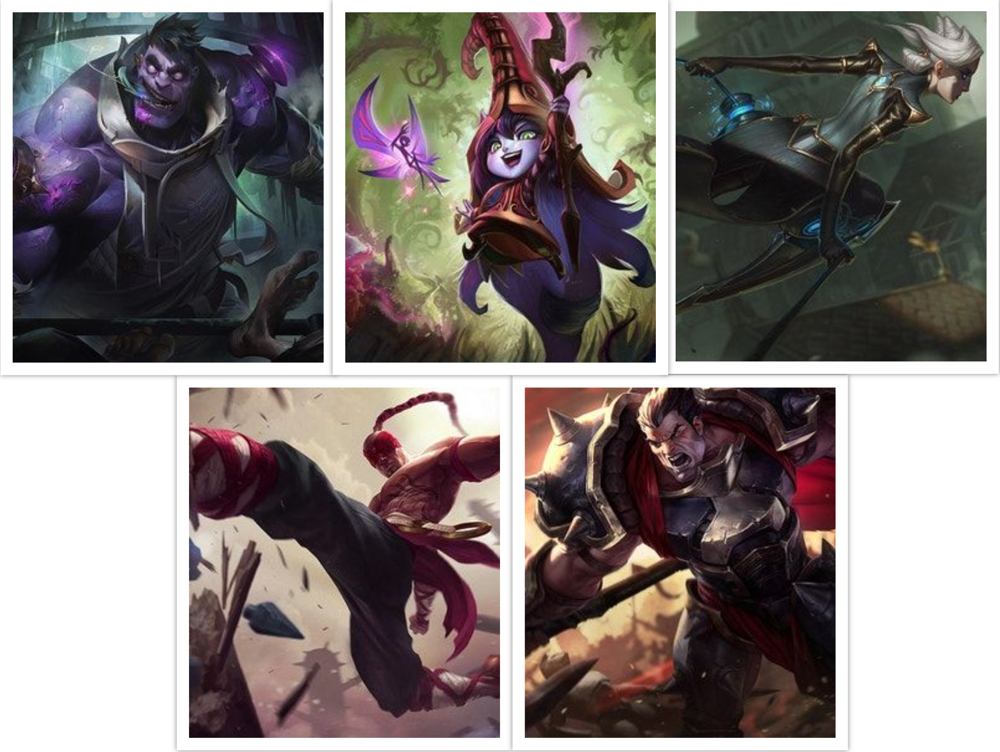

In [ ]:
# Load image from local storage
Image(filename = "/content/collage_top.png", width = 700, height = 600)

In [ ]:
top=np.array(df_top['champion'].unique())
top

#Recommendation For Champion playing at Bottom position:
From the complete dataframe ,we are finding records of players played at "Bottom" position because this is Default positon for a player to play at bottom in the Game League of Legend

In [ ]:
df_bot=df_lol_champ_pos[df_lol_champ_pos['position']=='bot']
df_bot.head()

,playerid,champion,result,position
3,oe:player:78081d0b3c01f1f295d52d53744261a,Miss Fortune,1,bot
8,oe:player:18bdb3898e7fecb3bb0be7ff075d509,Ezreal,0,bot
15,oe:player:18bdb3898e7fecb3bb0be7ff075d509,Kai'Sa,0,bot
20,oe:player:78081d0b3c01f1f295d52d53744261a,Miss Fortune,1,bot
27,oe:player:18bdb3898e7fecb3bb0be7ff075d509,Yasuo,0,bot


Create another dataframe through groupby 'playerid' and 'champion' and evaluate "Win rate" for each player by champion.
"Result here represent "win_rate".

In [ ]:
df_bot_groupby_champ=df_bot.groupby(['playerid','champion']).aggregate({'result':'mean'})
df_bot_groupby_champ.reset_index(level=[0,1],inplace=True)
df_bot_groupby_champ.head()

,playerid,champion,result
0,oe:player:00182d698df56f2ba8b462661776557,Ezreal,0.0
1,oe:player:00182d698df56f2ba8b462661776557,Kai'Sa,0.0
2,oe:player:00182d698df56f2ba8b462661776557,Tristana,0.0
3,oe:player:00e1677908b0a579a5870fbad836dcc,Tristana,0.0
4,oe:player:00ff83174dc14ce3f7b17e427b75e7f,Jinx,1.0


Find the count of number of games played by every player by "playerid" 

In [ ]:
counts_bot=df_bot_groupby_champ.playerid.value_counts()
counts_bot.head(10)

oe:player:9c2b5d4edfc9c79923a32bd589c6223    19
oe:player:416ea631f3b7a0d79f4263e00736f02    18
oe:player:713fae3c1b605df4ee976c6188182a1    18
oe:player:8a25863fe5045bb08949998a2c39329    17
oe:player:adb887df0adf1894f8af5073a5c6bc3    17
oe:player:10fcffece0ac7be85f09c4b51a75762    17
oe:player:c588a2d07b69ca4ba61c96aebd3f793    17
oe:player:bc890d965b40a02008da114b4b37122    17
oe:player:71a0da2a0d53879bffd88b072d4c593    17
oe:player:2e39f77d41c8deb6a891c30cf378383    17
Name: playerid, dtype: int64

#Take players only who has appeared at Bottom position in dataframe more than 15 times.

In [ ]:
df_bot_groupby_champ_greater_15=df_bot_groupby_champ[df_bot_groupby_champ.playerid.isin(counts_bot[counts_bot>=15].index)]
print('Number of players who have palyed 15 games or more =', len(df_bot_groupby_champ_greater_15))
print('Number of unique players in the final data = ', df_bot_groupby_champ_greater_15['playerid'].nunique())
print('Number of unique champions in the final data = ', df_bot_groupby_champ_greater_15['champion'].nunique())

Number of players who have palyed 15 games or more = 528
Number of unique players in the final data =  33
Number of unique champions in the final data =  40


#Pivot table of Each player and champion along with respective winrates.

In [ ]:
df_bot_groupby_champ_greater_15_pivot=df_bot_groupby_champ_greater_15.pivot(index = 'playerid', columns ='champion', values = 'result').fillna(0)
df_bot_groupby_champ_greater_15_pivot.head()

champion,Alistar,Aphelios,Ashe,Caitlyn,Draven,Ezreal,Gragas,Heimerdinger,Jhin,Jinx,Kai'Sa,Kalista,Karma,Karthus,Kindred,Kog'Maw,Lucian,Maokai,Miss Fortune,Neeko,Orianna,Rumble,Samira,Senna,Seraphine,Sett,Sion,Sivir,Soraka,Swain,Syndra,Tahm Kench,Tristana,Twitch,Varus,Vayne,Veigar,Viktor,Xayah,Ziggs
playerid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
oe:player:053ff46e09c658d5d80c8c65b9db7bc,0.0,0.000000,1.0,0.0,0.000000,1.000000,0.0,0.714286,0.500000,1.0,0.000000,0.000000,0.0,0.0,0.0,0.5,0.0,0.0,1.000000,1.0,0.0,0.0,0.000000,1.000000,0.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.000000,0.0,0.666667,0.0,1.00,1.0
oe:player:086e614735cb35b26688d0a62c42b27,0.0,0.428571,0.6,0.0,0.000000,0.333333,0.0,0.000000,0.727273,0.0,0.677419,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,0.285714,0.0,0.0,0.0,0.600000,0.769231,0.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.400000,0.0,0.333333,0.0,0.000000,0.0,0.40,0.0
oe:player:08caad57dbe4aeedc847b48102ffa56,0.0,0.000000,0.0,0.0,0.000000,0.571429,0.0,0.000000,0.000000,0.5,0.555556,0.666667,0.0,0.0,0.0,0.0,1.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.333333,0.500000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.600000,0.0,0.500000,0.0,0.000000,0.0,1.00,0.0
oe:player:10fcffece0ac7be85f09c4b51a75762,0.0,0.333333,0.5,0.0,0.000000,0.600000,0.0,0.000000,0.000000,1.0,0.695652,0.571429,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,0.0,0.0,1.000000,0.833333,0.500000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.600000,0.0,0.250000,0.0,0.000000,0.0,1.00,0.0
oe:player:2dda74ba3799fbc4822498ac6a82293,0.0,1.000000,1.0,0.5,0.666667,0.666667,0.0,0.000000,0.769231,0.4,0.617647,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.400000,0.0,0.0,0.0,0.666667,0.666667,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.333333,0.0,0.600000,0.0,0.000000,0.0,0.75,0.0


In [ ]:
#Split the data randomnly into train and test datasets into 70:30 ratio
train_data_bot, test_data_bot = train_test_split(df_bot_groupby_champ_greater_15, test_size = 0.3, random_state=0)
train_data_bot.head()

,playerid,champion,result
5233,oe:player:fba26591b2a75a8e370c2d51bc9eb90,Seraphine,0.666667
5229,oe:player:fba26591b2a75a8e370c2d51bc9eb90,Karma,0.000000
431,oe:player:10fcffece0ac7be85f09c4b51a75762,Miss Fortune,1.000000
5108,oe:player:f4d626477098810efdd3105f477bae5,Xayah,0.250000
2902,oe:player:8a25863fe5045bb08949998a2c39329,Ezreal,0.571429


#Groupby Champion ,find win_rate for each champion and count how many times that champion is chosen.

In [ ]:
train_data_bot_grouped = train_data_bot.groupby('champion').agg({'result': 'mean'}).reset_index()
train_data_bot_grouped.rename(columns = {'result': 'win_rate'},inplace=True)
num_of_times_chosen=train_data_bot.groupby('champion').agg({'result': 'count'}).reset_index()
train_data_bot_grouped['no_of_time_chosen']=num_of_times_chosen['result']
train_data_bot_grouped.head(10)

,champion,win_rate,no_of_time_chosen
0,Alistar,0.000000,1
1,Aphelios,0.520426,19
2,Ashe,0.712745,17
3,Caitlyn,0.503968,12
4,Draven,0.722222,3
5,Ezreal,0.390064,24
6,Gragas,1.000000,1
7,Heimerdinger,0.714286,1
8,Jhin,0.515481,17
9,Jinx,0.388636,22


In [ ]:
#Take champion choosen only more than 10 times to reduce the number of records.
train_data_bot_grouped_greater_5=train_data_bot_grouped[train_data_bot_grouped['no_of_time_chosen']>10]

In [ ]:
#Sort the "Champion" on recommended "win Rate". 
train_data_bot_grouped_greater_5_sort = train_data_bot_grouped_greater_5.sort_values(['win_rate','no_of_time_chosen','champion'], ascending = [0,0,1]) 
      
#Sort the "Champion" on recommended "win Rate". 
train_data_bot_grouped_greater_5_sort['rank'] = train_data_bot_grouped_greater_5_sort['win_rate'].rank(ascending=0, method='first') 
          
#Get the top 5 recommendations 
popularity_recommendations = train_data_bot_grouped_greater_5_sort.head(5) 
popularity_recommendations 

,champion,win_rate,no_of_time_chosen,rank
2,Ashe,0.712745,17,1.0
23,Seraphine,0.616497,14,2.0
34,Xayah,0.588248,18,3.0
22,Senna,0.581357,24,4.0
15,Lucian,0.569444,12,5.0


Function is created,which takes "Playerid" as input parameter and generate recommended output,containing top 5 champion on the decreasing order of Win rates at Bottom Position.

In [ ]:
# Use popularity based recommender model to make predictions
def recommend(player_id):     
    user_recommendations = popularity_recommendations 
          
    #Add playerid column for which the recommendations are being generated 
    user_recommendations['playerid'] = player_id 
      
    #Bring playerid column to the front 
    cols = user_recommendations.columns.tolist() 
    cols = cols[-1:] + cols[:-1] 
    user_recommendations = user_recommendations[cols] 
          
    return user_recommendations 

#Recommendation for player "abcd" came out as given below.

In [ ]:
recommend("abcd")

,playerid,champion,win_rate,no_of_time_chosen,rank
2,abcd,Ashe,0.712745,17,1.0
23,abcd,Seraphine,0.616497,14,2.0
34,abcd,Xayah,0.588248,18,3.0
22,abcd,Senna,0.581357,24,4.0
15,abcd,Lucian,0.569444,12,5.0


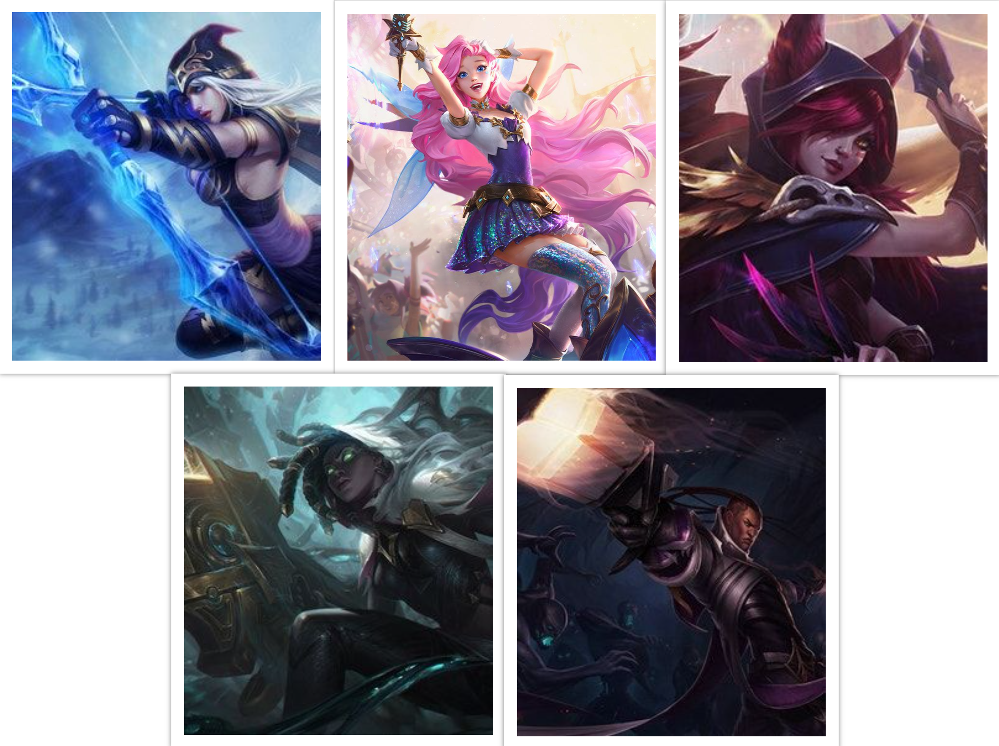

In [ ]:
# Load image from local storage
Image(filename = "/content/collage_bot.png", width = 700, height = 600)

In [ ]:
bot=np.array(df_bot['champion'].unique())
bot

#Recommendation For Champion playing at Support position:
From the complete dataframe ,we are finding records of players played at "Support" position because this is Default positon for a player to play as a support in the Game League of Legend

In [ ]:
df_support=df_lol_champ_pos[df_lol_champ_pos['position']=='sup']
df_support.head()

,playerid,champion,result,position
4,oe:player:dee54127bb56d2e2540ba71cc416f1c,Galio,1,sup
9,oe:player:b0ec3df39d61f953e7af0afd8eb8c4a,Leona,0,sup
16,oe:player:b0ec3df39d61f953e7af0afd8eb8c4a,Alistar,0,sup
21,oe:player:dee54127bb56d2e2540ba71cc416f1c,Galio,1,sup
28,oe:player:b0ec3df39d61f953e7af0afd8eb8c4a,Alistar,0,sup


Create another dataframe through groupby 'playerid' and 'champion' and evaluate "Win rate" for each player by champion.
"Result here represent "win_rate".

In [ ]:
df_support_groupby_champ=df_support.groupby(['playerid','champion']).aggregate({'result':'mean'})
df_support_groupby_champ.reset_index(level=[0,1],inplace=True)
df_support_groupby_champ.head()

,playerid,champion,result
0,oe:player:0015d99e65183977a9e65547b37f1cb,Alistar,0.400000
1,oe:player:0015d99e65183977a9e65547b37f1cb,Braum,0.500000
2,oe:player:0015d99e65183977a9e65547b37f1cb,Galio,0.666667
3,oe:player:0015d99e65183977a9e65547b37f1cb,Gragas,0.500000
4,oe:player:0015d99e65183977a9e65547b37f1cb,Leona,0.500000


Find the count of number of games played by every player by "playerid" 

In [ ]:
counts_support=df_support_groupby_champ.playerid.value_counts()
counts_support.head(10)

oe:player:35d2ca59893919e79b8611473b36021    20
oe:player:16c1637b4b44b008b4d6627f68ae30a    20
oe:player:6841f2d68619d53bdd1cdbf30b5be2c    19
oe:player:4c6afafdf99002c90d836b5e8d1a097    19
oe:player:dee54127bb56d2e2540ba71cc416f1c    18
oe:player:72130c3eb5e111889dac87f4333da1a    18
oe:player:07d1c57ec273126c65dbd1197abdb47    17
oe:player:81acc6bcde5c927c78e0990e9887f84    17
oe:player:1e6947ac7fb3a9529a9726eb692c8cc    17
oe:player:db79ce6ad35451c938fbe2995dabd37    17
Name: playerid, dtype: int64

#Take players only who has appeared at Support position in dataframe more than 15 times.

In [ ]:
df_support_groupby_champ_greater_15=df_support_groupby_champ[df_support_groupby_champ.playerid.isin(counts_support[counts_support>=15].index)]
print('Number of players who have played 15 games or more =', len(df_support_groupby_champ_greater_15))
print('Number of unique players in the final data = ', df_support_groupby_champ_greater_15['playerid'].nunique())
print('Number of unique champions in the final data = ', df_support_groupby_champ_greater_15['champion'].nunique())

Number of players who have played 15 games or more = 695
Number of unique players in the final data =  43
Number of unique champions in the final data =  50


#Pivot table of Each player and champion along with respective winrates.

In [ ]:
df_support_groupby_champ_greater_15_pivot=df_support_groupby_champ_greater_15.pivot(index = 'playerid', columns ='champion', values = 'result').fillna(0)
df_support_groupby_champ_greater_15_pivot.head()

champion,Alistar,Aphelios,Ashe,Bard,Blitzcrank,Braum,Cho'Gath,Galio,Gragas,Heimerdinger,Ivern,Janna,Jarvan IV,Kai'Sa,Karma,Karthus,Lee Sin,Leona,Lulu,Lux,Maokai,Morgana,Nami,Nasus,Nautilus,Neeko,Ornn,Pantheon,Poppy,Pyke,Rakan,Rell,Rumble,Senna,Seraphine,Sett,Shen,Sion,Soraka,Sylas,Tahm Kench,Taric,Thresh,Trundle,Xerath,Yuumi,Zac,Zilean,Zoe,Zyra
playerid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
oe:player:079a790e068f200b95b0dcfe78d9234,0.222222,0.0,0.0,0.0,0.0,0.200000,0.0,0.0,0.153846,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.250000,0.0,0.0,0.00,0.0,0.0,0.0,0.200000,0.0,0.0,0.0,0.0,0.0,0.333333,0.500000,0.0,0.0,0.000000,0.2,0.0,0.0,0.0,0.0,0.000000,0.0,0.300000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
oe:player:07d1c57ec273126c65dbd1197abdb47,0.615385,0.0,0.0,1.0,0.0,0.000000,0.0,0.0,1.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.200000,1.0,0.0,0.25,0.0,0.0,0.0,0.500000,0.0,0.0,1.0,0.0,0.0,0.500000,1.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,0.714286,0.0,0.0,0.0,0.0,0.0,0.0,0.0
oe:player:0908c66a5c361f682282599e75b334f,0.454545,0.0,0.0,0.5,0.0,0.666667,0.0,1.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.428571,1.0,0.0,1.00,0.0,0.0,0.0,0.777778,0.0,0.0,1.0,0.0,0.0,0.750000,0.666667,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
oe:player:15b2b9b4cd18e3c1d985c867a6fb03f,0.250000,0.0,0.0,0.0,1.0,0.000000,0.0,0.5,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,1.0,0.00,0.0,0.0,0.0,1.000000,0.0,0.0,0.0,0.0,0.0,1.000000,0.714286,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.571429,0.0,0.0,0.0,0.0,0.0,0.0,0.0
oe:player:16c1637b4b44b008b4d6627f68ae30a,1.000000,0.0,0.0,0.0,0.0,0.500000,0.0,1.0,0.500000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.333333,1.0,0.0,1.00,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,1.0,0.600000,0.500000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.666667,0.0,0.500000,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
#Split the data randomnly into train and test datasets into 70:30 ratio
train_data_support, test_data_support = train_test_split(df_support_groupby_champ_greater_15, test_size = 0.3, random_state=0)
train_data_support.head()

,playerid,champion,result
715,oe:player:1e6947ac7fb3a9529a9726eb692c8cc,Leona,0.000000
5365,oe:player:f55951f099dcf0a703ecd190a1475fd,Tahm Kench,1.000000
1464,oe:player:41c5f02f8439b36ea5d0d37c7b4a2c4,Galio,0.428571
3244,oe:player:9974ead3a4ce228d5eb01fc8340d6df,Rakan,1.000000
3484,oe:player:a39d2bfa964a33bd2781fd469425c3f,Gragas,0.500000


#Groupby Champion ,find win_rate for each champion and count how many times that champion is chosen.

In [ ]:
train_data_support_grouped = train_data_support.groupby('champion').agg({'result': 'mean'}).reset_index()
train_data_support_grouped.rename(columns = {'result': 'win_rate'},inplace=True)
num_of_times_chosen=train_data_support.groupby('champion').agg({'result': 'count'}).reset_index()
train_data_support_grouped['no_of_time_chosen']=num_of_times_chosen['result']
train_data_support_grouped.head(10)

,champion,win_rate,no_of_time_chosen
0,Alistar,0.434020,28
1,Aphelios,0.000000,1
2,Bard,0.351389,12
3,Blitzcrank,0.416667,14
4,Braum,0.545513,26
5,Cho'Gath,1.000000,1
6,Galio,0.506727,29
7,Gragas,0.460888,29
8,Janna,0.500000,3
9,Jarvan IV,0.437500,4


In [ ]:
#Take champion choosen only more than 10 times to reduce the number of records.
train_data_support_grouped_greater_5=train_data_support_grouped[train_data_support_grouped['no_of_time_chosen']>10]

In [ ]:
#Sort the "Champion" on recommended "win Rate". 
train_data_support_grouped_greater_5_sort = train_data_support_grouped_greater_5.sort_values(['win_rate','no_of_time_chosen','champion'], ascending = [0,0,1]) 
      
#Sort the "Champion" on recommended "win Rate". 
train_data_support_grouped_greater_5_sort['rank'] = train_data_support_grouped_greater_5_sort['win_rate'].rank(ascending=0, method='first') 
          
#Get the top 5 recommendations 
popularity_recommendations = train_data_support_grouped_greater_5_sort.head(5) 
popularity_recommendations 

,champion,win_rate,no_of_time_chosen,rank
17,Maokai,0.711538,13,1.0
24,Rakan,0.677083,24,2.0
33,Tahm Kench,0.609286,25,3.0
4,Braum,0.545513,26,4.0
25,Rell,0.531622,27,5.0


Function is created,which takes "Playerid" as input parameter and generate recommended output,containing top 5 champion on the decreasing order of Win rates at Support Position.

In [ ]:
# Use popularity based recommender model to make predictions
def recommend(player_id):     
    user_recommendations = popularity_recommendations 
          
    #Add playerid column for which the recommendations are being generated 
    user_recommendations['playerid'] = player_id 
      
    #Bring playerid column to the front 
    cols = user_recommendations.columns.tolist() 
    cols = cols[-1:] + cols[:-1] 
    user_recommendations = user_recommendations[cols] 
          
    return user_recommendations 

#Recommendation for player "abcd" came out as given below.

In [ ]:
recommend("abcd")

,playerid,champion,win_rate,no_of_time_chosen,rank
17,abcd,Maokai,0.711538,13,1.0
24,abcd,Rakan,0.677083,24,2.0
33,abcd,Tahm Kench,0.609286,25,3.0
4,abcd,Braum,0.545513,26,4.0
25,abcd,Rell,0.531622,27,5.0


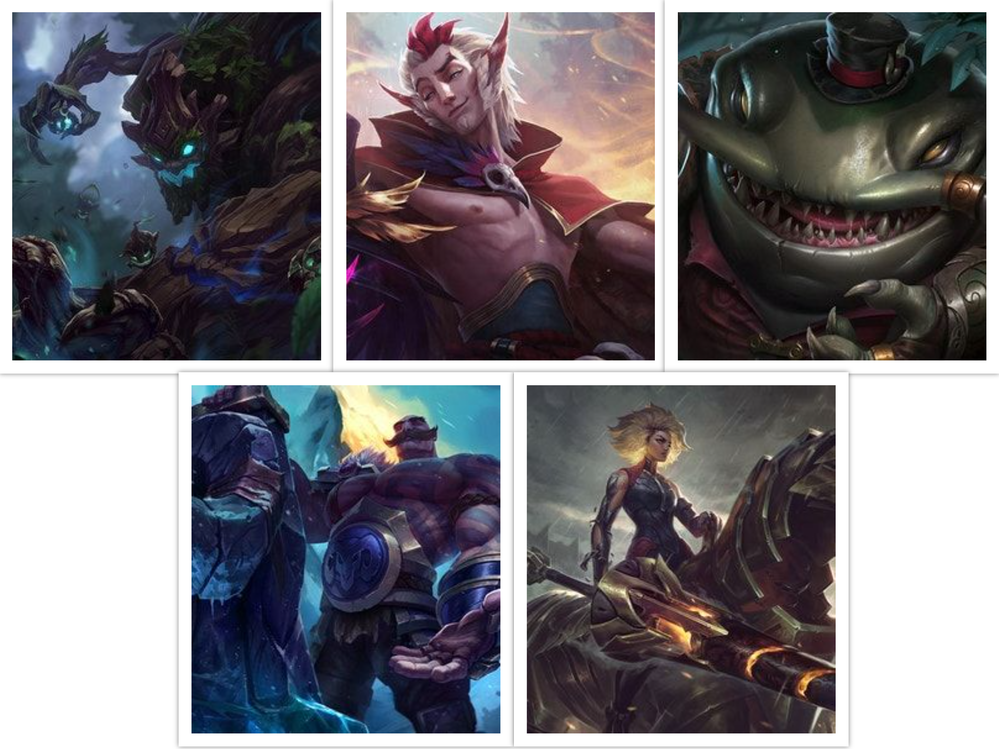

In [ ]:
# Load image from local storage
Image(filename = "/content/collage_sup.png", width = 700, height = 600)

In [ ]:
sup=np.array(df_support['champion'].unique())
sup

array(['Galio', 'Leona', 'Alistar', 'Maokai', 'Thresh', 'Shen',
       'Nautilus', 'Braum', 'Pantheon', 'Sett', 'Morgana', 'Lulu',
       'Rakan', 'Gragas', 'Zilean', 'Taric', 'Rell', 'Seraphine', 'Janna',
       'Bard', 'Nami', 'Karma', 'Orianna', 'Ivern'], dtype=object)